### Librerías Necesarias

In [74]:
# Pandas nos permite trabajar con DataFrames
import pandas as pd
# Para la visualización de datos
import plotly.express as px
import json

%matplotlib inline
import matplotlib.pyplot as plt


### Cargando los datasets

In [5]:
# Cargamos el dataset de entrenamiento, este contiene todos los datos, incluídas las etiquetas.
df_training = pd.read_csv('data/TrainingWiDS2021.csv')
print("Dimensiones del dataset (filas, columnas)  : ", df_training.shape)
df_training.sample(5)

Dimensiones del dataset (filas, columnas)  :  (130157, 181)


,Unnamed: 0,encounter_id,hospital_id,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,...,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,diabetes_mellitus
72304,72305,152484,159,72.0,29.838726,1,Caucasian,M,180.3,NaN,...,NaN,NaN,0,0,0,0,0,0,0,1
114168,114169,257792,141,51.0,28.480912,0,Caucasian,F,162.6,Emergency Department,...,NaN,NaN,0,0,0,0,0,0,0,0
12251,12252,174394,85,62.0,25.935492,0,NaN,F,175.3,Floor,...,NaN,NaN,0,0,0,0,0,0,0,1
104885,104886,255545,75,51.0,22.141165,1,Caucasian,F,175.3,Operating Room,...,NaN,NaN,0,0,0,0,0,0,0,0
24777,24778,230714,55,59.0,42.099298,0,Caucasian,F,157.4,Emergency Department,...,NaN,NaN,0,0,0,0,0,0,0,0


In [7]:
# Cargamos el dataset de test, que contiene los datos sin valores en 
df_unlabeled = pd.read_csv('data/UnlabeledWiDS2021.csv')
print("Dimensiones del dataset (filas, columnas)  : ", df_unlabeled.shape)
df_unlabeled.sample(5)

Dimensiones del dataset (filas, columnas)  :  (10234, 180)


,Unnamed: 0,encounter_id,hospital_id,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,...,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
1193,1194,139144,10179,87,16.6,0,Asian,M,170.2,NaN,...,NaN,NaN,NaN,0,0,0,0,0,0,0
4959,4960,136825,10030,53,23.0,0,Caucasian,M,193.0,NaN,...,NaN,NaN,NaN,0,0,0,0,0,0,0
948,949,138720,10184,80,20.3,0,Caucasian,F,157.5,Emergency Department,...,NaN,NaN,NaN,0,0,0,0,0,0,0
3717,3718,145272,10108,57,53.4,0,Caucasian,F,168.0,Direct Admit,...,NaN,NaN,NaN,0,0,0,0,0,0,0
6854,6855,140173,10113,63,23.0,1,Caucasian,M,175.0,Operating Room,...,341.0,341.0,341.0,0,0,0,0,0,0,0


In [8]:
# Diccionario de datos y términos
df_dictionary = pd.read_csv('data/DataDictionaryWiDS2021.csv')
print("Dimensiones del dataset (filas, columnas)  : ", df_dictionary.shape)
df_dictionary.tail(10)

Dimensiones del dataset (filas, columnas)  :  (181, 6)


,Category,Variable Name,Unit of Measure,Data Type,Description,Example
171,labs blood gas,h1_pao2fio2ratio_max,Fraction,numeric,The highest fraction of inspired oxygen for th...,0.21
172,labs blood gas,h1_pao2fio2ratio_min,Fraction,numeric,The lowest fraction of inspired oxygen for the...,0.21
173,APACHE comorbidity,aids,None,binary,Whether the patient has a definitive diagnosis...,1
174,APACHE comorbidity,cirrhosis,None,binary,Whether the patient has a history of heavy alc...,1
175,APACHE comorbidity,hepatic_failure,None,binary,Whether the patient has cirrhosis and addition...,1
176,APACHE comorbidity,immunosuppression,None,binary,Whether the patient has their immune system su...,1
177,APACHE comorbidity,leukemia,None,binary,Whether the patient has been diagnosed with ac...,1
178,APACHE comorbidity,lymphoma,None,binary,Whether the patient has been diagnosed with no...,1
179,APACHE comorbidity,solid_tumor_with_metastasis,None,binary,Whether the patient has been diagnosed with an...,1
180,Target Variable,diabetes_mellitus,None,binary,Whether the patient has been diagnosed with di...,1


# Análisis exploratorio

In [9]:
# Información sobre el tipo de datos de las columnas de nuestro dataset
print(df_training.dtypes)
# df_training.info()

Unnamed: 0                       int64
encounter_id                     int64
hospital_id                      int64
age                            float64
bmi                            float64
                                ...   
immunosuppression                int64
leukemia                         int64
lymphoma                         int64
solid_tumor_with_metastasis      int64
diabetes_mellitus                int64
Length: 181, dtype: object


In [10]:
# Descripción estadística básica de las columnas numéricas del dataset
df_training.describe()

,Unnamed: 0,encounter_id,hospital_id,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,readmission_status,...,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,diabetes_mellitus
count,130157.000000,130157.000000,130157.000000,125169.000000,125667.000000,130157.000000,128080.000000,130157.000000,130157.000000,130157.0,...,16760.000000,16760.000000,130157.00000,130157.000000,130157.000000,130157.000000,130157.000000,130157.000000,130157.000000,130157.000000
mean,65079.000000,213000.856519,106.102131,61.995103,29.110260,0.189840,169.607219,662.428344,0.839933,0.0,...,247.525419,239.617358,0.00103,0.016081,0.013599,0.025669,0.007307,0.004187,0.020852,0.216285
std,37573.233831,38109.828146,63.482277,16.822880,8.262776,0.392176,10.833085,304.259843,2.485337,0.0,...,131.440167,128.562211,0.03207,0.125786,0.115819,0.158146,0.085166,0.064574,0.142888,0.411712
min,1.000000,147000.000000,1.000000,0.000000,14.844926,0.000000,137.200000,82.000000,-0.250000,0.0,...,42.000000,38.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32540.000000,180001.000000,49.000000,52.000000,23.598006,0.000000,162.500000,427.000000,0.045833,0.0,...,144.000000,138.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,65079.000000,213014.000000,112.000000,64.000000,27.564749,0.000000,170.100000,653.000000,0.155556,0.0,...,228.125000,218.750000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,97618.000000,246002.000000,165.000000,75.000000,32.803127,0.000000,177.800000,969.000000,0.423611,0.0,...,333.000000,324.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,130157.000000,279000.000000,204.000000,89.000000,67.814990,1.000000,195.590000,1111.000000,175.627778,0.0,...,720.000000,654.813793,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [11]:
df_training.corr()

,Unnamed: 0,encounter_id,hospital_id,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,readmission_status,...,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,diabetes_mellitus
Unnamed: 0,1.000000,-0.001862,-0.000194,-0.037704,-0.003985,-0.016849,0.008826,0.989875,-0.009097,NaN,...,0.023807,0.035525,0.006372,-0.005301,0.000224,-0.019898,0.003937,-0.000596,-0.005415,-0.019601
encounter_id,-0.001862,1.000000,-0.001463,-0.001376,0.003641,0.001618,0.001393,-0.001498,-0.001066,NaN,...,-0.000578,-0.001582,0.002830,0.000727,-0.002442,-0.000217,-0.001831,0.002531,0.006676,-0.002007
hospital_id,-0.000194,-0.001463,1.000000,-0.019738,0.004834,0.028321,0.022645,0.005414,-0.005174,NaN,...,0.011336,0.000239,0.000956,0.002127,0.003403,-0.003745,0.002609,0.001734,-0.009420,0.001937
age,-0.037704,-0.001376,-0.019738,1.000000,-0.083176,0.058116,-0.113424,-0.035828,0.049000,NaN,...,-0.100749,-0.104265,-0.028410,-0.025476,-0.019699,0.021990,0.029104,0.022947,0.026277,0.081019
bmi,-0.003985,0.003641,0.004834,-0.083176,1.000000,0.011846,-0.056617,-0.007218,0.000595,NaN,...,-0.180801,-0.178718,-0.020725,-0.002822,-0.001782,-0.031128,-0.013784,-0.010434,-0.041589,0.169043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
immunosuppression,-0.019898,-0.000217,-0.003745,0.021990,-0.031128,-0.012172,0.000810,-0.021252,0.038840,NaN,...,-0.015663,-0.012850,0.017513,0.000879,0.002754,1.000000,0.130967,0.100071,0.277214,-0.003022
leukemia,0.003937,-0.001831,0.002609,0.029104,-0.013784,-0.016686,0.003450,0.003795,0.055669,NaN,...,-0.002058,-0.001054,-0.002754,-0.003796,0.000052,0.130967,1.000000,0.029363,0.008315,0.003574
lymphoma,-0.000596,0.002531,0.001734,0.022947,-0.010434,-0.005905,0.003788,-0.000570,0.016220,NaN,...,0.004547,0.005241,0.012759,-0.000723,-0.000423,0.100071,0.029363,1.000000,0.017183,-0.000253
solid_tumor_with_metastasis,-0.005415,0.006676,-0.009420,0.026277,-0.041589,0.021358,0.004357,-0.005885,0.033236,NaN,...,0.006640,0.007709,-0.001331,-0.002840,0.005150,0.277214,0.008315,0.017183,1.000000,-0.013190


In [12]:
# Analisis del balanceo de datos. 
# Porcentaje personas con diabetes
print("Conteo de personas que mueren y no")
print(df_training['diabetes_mellitus'].value_counts())
print("\nPorcentajes de personas que mueren y no")
df_training['diabetes_mellitus'].value_counts(normalize=True)

# Claramente nos encontramos ante un dataset imbalanceado.

Conteo de personas que mueren y no
0    102006
1     28151
Name: diabetes_mellitus, dtype: int64

Porcentajes de personas que mueren y no


0    0.783715
1    0.216285
Name: diabetes_mellitus, dtype: float64

# Análisis Visual

In [13]:
#Columnas del dataset
print("\nTodas las columnas del dataset")
print(df_training.columns.tolist())

#Columnas de tipo numérico
print("\nColumnas de tipo numérico")
numeric_cols = df_training.select_dtypes(include=["int", "float"]).columns.tolist()
print(numeric_cols)

#Columnas de tipo texto
print("\nColumnas de tipo texto")
df_training.select_dtypes(include=['object', 'bool']).columns.tolist()


Todas las columnas del dataset
['Unnamed: 0', 'encounter_id', 'hospital_id', 'age', 'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height', 'hospital_admit_source', 'icu_admit_source', 'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'readmission_status', 'weight', 'albumin_apache', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'bilirubin_apache', 'bun_apache', 'creatinine_apache', 'fio2_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'glucose_apache', 'heart_rate_apache', 'hematocrit_apache', 'intubated_apache', 'map_apache', 'paco2_apache', 'paco2_for_ph_apache', 'pao2_apache', 'ph_apache', 'resprate_apache', 'sodium_apache', 'temp_apache', 'urineoutput_apache', 'ventilated_apache', 'wbc_apache', 'd1_diasbp_invasive_max', 'd1_diasbp_invasive_min', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_invas

['ethnicity',
 'gender',
 'hospital_admit_source',
 'icu_admit_source',
 'icu_stay_type',
 'icu_type']

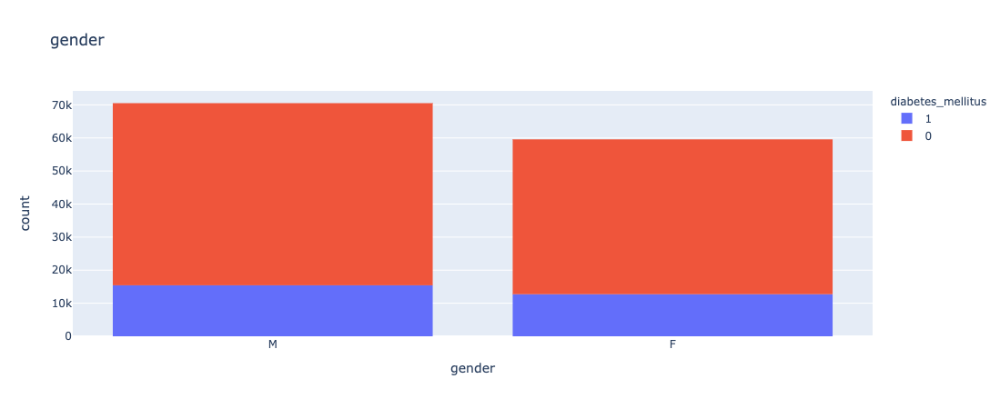

In [15]:
#@title Histograma { run: "auto", form-width: "50%" }
histograma_variable = "gender" #@param ['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age', 'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height', 'hospital_admit_source', 'icu_admit_source', 'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'readmission_status', 'weight', 'albumin_apache', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'bilirubin_apache', 'bun_apache', 'creatinine_apache', 'fio2_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'glucose_apache', 'heart_rate_apache', 'hematocrit_apache', 'intubated_apache', 'map_apache', 'paco2_apache', 'paco2_for_ph_apache', 'pao2_apache', 'ph_apache', 'resprate_apache', 'sodium_apache', 'temp_apache', 'urineoutput_apache', 'ventilated_apache', 'wbc_apache', 'd1_diasbp_invasive_max', 'd1_diasbp_invasive_min', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_invasive_max', 'd1_mbp_invasive_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_invasive_max', 'd1_sysbp_invasive_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_invasive_max', 'h1_diasbp_invasive_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_invasive_max', 'h1_mbp_invasive_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h1_resprate_min', 'h1_spo2_max', 'h1_spo2_min', 'h1_sysbp_invasive_max', 'h1_sysbp_invasive_min', 'h1_sysbp_max', 'h1_sysbp_min', 'h1_sysbp_noninvasive_max', 'h1_sysbp_noninvasive_min', 'h1_temp_max', 'h1_temp_min', 'd1_albumin_max', 'd1_albumin_min', 'd1_bilirubin_max', 'd1_bilirubin_min', 'd1_bun_max', 'd1_bun_min', 'd1_calcium_max', 'd1_calcium_min', 'd1_creatinine_max', 'd1_creatinine_min', 'd1_glucose_max', 'd1_glucose_min', 'd1_hco3_max', 'd1_hco3_min', 'd1_hemaglobin_max', 'd1_hemaglobin_min', 'd1_hematocrit_max', 'd1_hematocrit_min', 'd1_inr_max', 'd1_inr_min', 'd1_lactate_max', 'd1_lactate_min', 'd1_platelets_max', 'd1_platelets_min', 'd1_potassium_max', 'd1_potassium_min', 'd1_sodium_max', 'd1_sodium_min', 'd1_wbc_max', 'd1_wbc_min', 'h1_albumin_max', 'h1_albumin_min', 'h1_bilirubin_max', 'h1_bilirubin_min', 'h1_bun_max', 'h1_bun_min', 'h1_calcium_max', 'h1_calcium_min', 'h1_creatinine_max', 'h1_creatinine_min', 'h1_glucose_max', 'h1_glucose_min', 'h1_hco3_max', 'h1_hco3_min', 'h1_hemaglobin_max', 'h1_hemaglobin_min', 'h1_hematocrit_max', 'h1_hematocrit_min', 'h1_inr_max', 'h1_inr_min', 'h1_lactate_max', 'h1_lactate_min', 'h1_platelets_max', 'h1_platelets_min', 'h1_potassium_max', 'h1_potassium_min', 'h1_sodium_max', 'h1_sodium_min', 'h1_wbc_max', 'h1_wbc_min', 'd1_arterial_pco2_max', 'd1_arterial_pco2_min', 'd1_arterial_ph_max', 'd1_arterial_ph_min', 'd1_arterial_po2_max', 'd1_arterial_po2_min', 'd1_pao2fio2ratio_max', 'd1_pao2fio2ratio_min', 'h1_arterial_pco2_max', 'h1_arterial_pco2_min', 'h1_arterial_ph_max', 'h1_arterial_ph_min', 'h1_arterial_po2_max', 'h1_arterial_po2_min', 'h1_pao2fio2ratio_max', 'h1_pao2fio2ratio_min', 'apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob', 'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure', 'immunosuppression', 'leukemia', 'lymphoma', 'solid_tumor_with_metastasis', 'apache_3j_bodysystem', 'apache_2_bodysystem']

px.histogram(df_training, x=histograma_variable, title=histograma_variable, color='diabetes_mellitus')


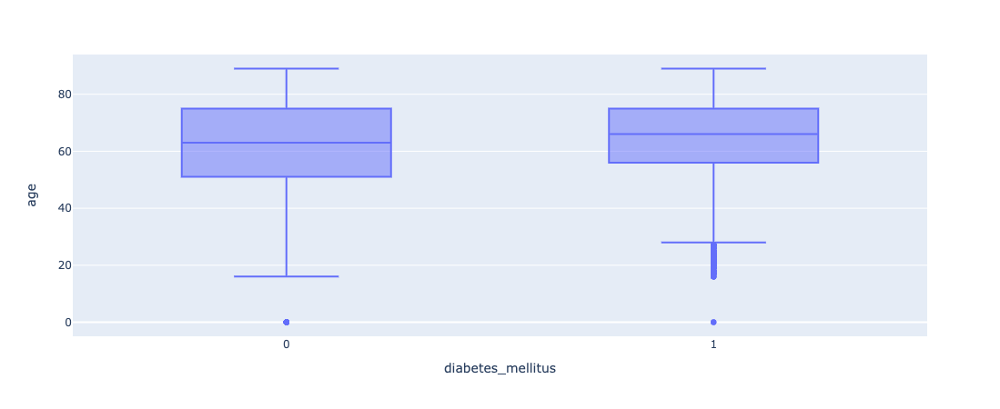

In [16]:
#@title Boxplot { run: "auto", form-width: "70%" }
box_var_y = "age" #@param ['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age', 'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height', 'hospital_admit_source', 'icu_admit_source', 'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'readmission_status', 'weight', 'albumin_apache', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'bilirubin_apache', 'bun_apache', 'creatinine_apache', 'fio2_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'glucose_apache', 'heart_rate_apache', 'hematocrit_apache', 'intubated_apache', 'map_apache', 'paco2_apache', 'paco2_for_ph_apache', 'pao2_apache', 'ph_apache', 'resprate_apache', 'sodium_apache', 'temp_apache', 'urineoutput_apache', 'ventilated_apache', 'wbc_apache', 'd1_diasbp_invasive_max', 'd1_diasbp_invasive_min', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_invasive_max', 'd1_mbp_invasive_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_invasive_max', 'd1_sysbp_invasive_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_invasive_max', 'h1_diasbp_invasive_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_invasive_max', 'h1_mbp_invasive_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h1_resprate_min', 'h1_spo2_max', 'h1_spo2_min', 'h1_sysbp_invasive_max', 'h1_sysbp_invasive_min', 'h1_sysbp_max', 'h1_sysbp_min', 'h1_sysbp_noninvasive_max', 'h1_sysbp_noninvasive_min', 'h1_temp_max', 'h1_temp_min', 'd1_albumin_max', 'd1_albumin_min', 'd1_bilirubin_max', 'd1_bilirubin_min', 'd1_bun_max', 'd1_bun_min', 'd1_calcium_max', 'd1_calcium_min', 'd1_creatinine_max', 'd1_creatinine_min', 'd1_glucose_max', 'd1_glucose_min', 'd1_hco3_max', 'd1_hco3_min', 'd1_hemaglobin_max', 'd1_hemaglobin_min', 'd1_hematocrit_max', 'd1_hematocrit_min', 'd1_inr_max', 'd1_inr_min', 'd1_lactate_max', 'd1_lactate_min', 'd1_platelets_max', 'd1_platelets_min', 'd1_potassium_max', 'd1_potassium_min', 'd1_sodium_max', 'd1_sodium_min', 'd1_wbc_max', 'd1_wbc_min', 'h1_albumin_max', 'h1_albumin_min', 'h1_bilirubin_max', 'h1_bilirubin_min', 'h1_bun_max', 'h1_bun_min', 'h1_calcium_max', 'h1_calcium_min', 'h1_creatinine_max', 'h1_creatinine_min', 'h1_glucose_max', 'h1_glucose_min', 'h1_hco3_max', 'h1_hco3_min', 'h1_hemaglobin_max', 'h1_hemaglobin_min', 'h1_hematocrit_max', 'h1_hematocrit_min', 'h1_inr_max', 'h1_inr_min', 'h1_lactate_max', 'h1_lactate_min', 'h1_platelets_max', 'h1_platelets_min', 'h1_potassium_max', 'h1_potassium_min', 'h1_sodium_max', 'h1_sodium_min', 'h1_wbc_max', 'h1_wbc_min', 'd1_arterial_pco2_max', 'd1_arterial_pco2_min', 'd1_arterial_ph_max', 'd1_arterial_ph_min', 'd1_arterial_po2_max', 'd1_arterial_po2_min', 'd1_pao2fio2ratio_max', 'd1_pao2fio2ratio_min', 'h1_arterial_pco2_max', 'h1_arterial_pco2_min', 'h1_arterial_ph_max', 'h1_arterial_ph_min', 'h1_arterial_po2_max', 'h1_arterial_po2_min', 'h1_pao2fio2ratio_max', 'h1_pao2fio2ratio_min', 'apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob', 'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure', 'immunosuppression', 'leukemia', 'lymphoma', 'solid_tumor_with_metastasis', 'apache_3j_bodysystem', 'apache_2_bodysystem']
box_var_x = "diabetes_mellitus" #@param ['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age', 'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height', 'hospital_admit_source', 'icu_admit_source', 'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'readmission_status', 'weight', 'albumin_apache', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'bilirubin_apache', 'bun_apache', 'creatinine_apache', 'fio2_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'glucose_apache', 'heart_rate_apache', 'hematocrit_apache', 'intubated_apache', 'map_apache', 'paco2_apache', 'paco2_for_ph_apache', 'pao2_apache', 'ph_apache', 'resprate_apache', 'sodium_apache', 'temp_apache', 'urineoutput_apache', 'ventilated_apache', 'wbc_apache', 'd1_diasbp_invasive_max', 'd1_diasbp_invasive_min', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_invasive_max', 'd1_mbp_invasive_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_invasive_max', 'd1_sysbp_invasive_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_invasive_max', 'h1_diasbp_invasive_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_invasive_max', 'h1_mbp_invasive_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h1_resprate_min', 'h1_spo2_max', 'h1_spo2_min', 'h1_sysbp_invasive_max', 'h1_sysbp_invasive_min', 'h1_sysbp_max', 'h1_sysbp_min', 'h1_sysbp_noninvasive_max', 'h1_sysbp_noninvasive_min', 'h1_temp_max', 'h1_temp_min', 'd1_albumin_max', 'd1_albumin_min', 'd1_bilirubin_max', 'd1_bilirubin_min', 'd1_bun_max', 'd1_bun_min', 'd1_calcium_max', 'd1_calcium_min', 'd1_creatinine_max', 'd1_creatinine_min', 'd1_glucose_max', 'd1_glucose_min', 'd1_hco3_max', 'd1_hco3_min', 'd1_hemaglobin_max', 'd1_hemaglobin_min', 'd1_hematocrit_max', 'd1_hematocrit_min', 'd1_inr_max', 'd1_inr_min', 'd1_lactate_max', 'd1_lactate_min', 'd1_platelets_max', 'd1_platelets_min', 'd1_potassium_max', 'd1_potassium_min', 'd1_sodium_max', 'd1_sodium_min', 'd1_wbc_max', 'd1_wbc_min', 'h1_albumin_max', 'h1_albumin_min', 'h1_bilirubin_max', 'h1_bilirubin_min', 'h1_bun_max', 'h1_bun_min', 'h1_calcium_max', 'h1_calcium_min', 'h1_creatinine_max', 'h1_creatinine_min', 'h1_glucose_max', 'h1_glucose_min', 'h1_hco3_max', 'h1_hco3_min', 'h1_hemaglobin_max', 'h1_hemaglobin_min', 'h1_hematocrit_max', 'h1_hematocrit_min', 'h1_inr_max', 'h1_inr_min', 'h1_lactate_max', 'h1_lactate_min', 'h1_platelets_max', 'h1_platelets_min', 'h1_potassium_max', 'h1_potassium_min', 'h1_sodium_max', 'h1_sodium_min', 'h1_wbc_max', 'h1_wbc_min', 'd1_arterial_pco2_max', 'd1_arterial_pco2_min', 'd1_arterial_ph_max', 'd1_arterial_ph_min', 'd1_arterial_po2_max', 'd1_arterial_po2_min', 'd1_pao2fio2ratio_max', 'd1_pao2fio2ratio_min', 'h1_arterial_pco2_max', 'h1_arterial_pco2_min', 'h1_arterial_ph_max', 'h1_arterial_ph_min', 'h1_arterial_po2_max', 'h1_arterial_po2_min', 'h1_pao2fio2ratio_max', 'h1_pao2fio2ratio_min', 'apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob', 'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure', 'immunosuppression', 'leukemia', 'lymphoma', 'solid_tumor_with_metastasis', 'apache_3j_bodysystem', 'apache_2_bodysystem']

px.box(df_training, y=box_var_y, x=box_var_x)

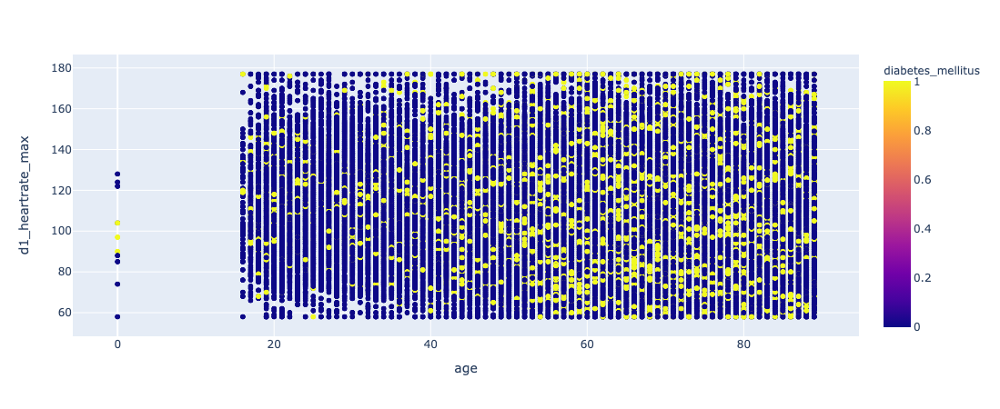

In [18]:
#@title Scatterplot { run: "auto", form-width: "70%" }
scatter_var_x = "age" #@param ['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age', 'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height', 'hospital_admit_source', 'icu_admit_source', 'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'readmission_status', 'weight', 'albumin_apache', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'bilirubin_apache', 'bun_apache', 'creatinine_apache', 'fio2_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'glucose_apache', 'heart_rate_apache', 'hematocrit_apache', 'intubated_apache', 'map_apache', 'paco2_apache', 'paco2_for_ph_apache', 'pao2_apache', 'ph_apache', 'resprate_apache', 'sodium_apache', 'temp_apache', 'urineoutput_apache', 'ventilated_apache', 'wbc_apache', 'd1_diasbp_invasive_max', 'd1_diasbp_invasive_min', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_invasive_max', 'd1_mbp_invasive_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_invasive_max', 'd1_sysbp_invasive_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_invasive_max', 'h1_diasbp_invasive_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_invasive_max', 'h1_mbp_invasive_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h1_resprate_min', 'h1_spo2_max', 'h1_spo2_min', 'h1_sysbp_invasive_max', 'h1_sysbp_invasive_min', 'h1_sysbp_max', 'h1_sysbp_min', 'h1_sysbp_noninvasive_max', 'h1_sysbp_noninvasive_min', 'h1_temp_max', 'h1_temp_min', 'd1_albumin_max', 'd1_albumin_min', 'd1_bilirubin_max', 'd1_bilirubin_min', 'd1_bun_max', 'd1_bun_min', 'd1_calcium_max', 'd1_calcium_min', 'd1_creatinine_max', 'd1_creatinine_min', 'd1_glucose_max', 'd1_glucose_min', 'd1_hco3_max', 'd1_hco3_min', 'd1_hemaglobin_max', 'd1_hemaglobin_min', 'd1_hematocrit_max', 'd1_hematocrit_min', 'd1_inr_max', 'd1_inr_min', 'd1_lactate_max', 'd1_lactate_min', 'd1_platelets_max', 'd1_platelets_min', 'd1_potassium_max', 'd1_potassium_min', 'd1_sodium_max', 'd1_sodium_min', 'd1_wbc_max', 'd1_wbc_min', 'h1_albumin_max', 'h1_albumin_min', 'h1_bilirubin_max', 'h1_bilirubin_min', 'h1_bun_max', 'h1_bun_min', 'h1_calcium_max', 'h1_calcium_min', 'h1_creatinine_max', 'h1_creatinine_min', 'h1_glucose_max', 'h1_glucose_min', 'h1_hco3_max', 'h1_hco3_min', 'h1_hemaglobin_max', 'h1_hemaglobin_min', 'h1_hematocrit_max', 'h1_hematocrit_min', 'h1_inr_max', 'h1_inr_min', 'h1_lactate_max', 'h1_lactate_min', 'h1_platelets_max', 'h1_platelets_min', 'h1_potassium_max', 'h1_potassium_min', 'h1_sodium_max', 'h1_sodium_min', 'h1_wbc_max', 'h1_wbc_min', 'd1_arterial_pco2_max', 'd1_arterial_pco2_min', 'd1_arterial_ph_max', 'd1_arterial_ph_min', 'd1_arterial_po2_max', 'd1_arterial_po2_min', 'd1_pao2fio2ratio_max', 'd1_pao2fio2ratio_min', 'h1_arterial_pco2_max', 'h1_arterial_pco2_min', 'h1_arterial_ph_max', 'h1_arterial_ph_min', 'h1_arterial_po2_max', 'h1_arterial_po2_min', 'h1_pao2fio2ratio_max', 'h1_pao2fio2ratio_min', 'apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob', 'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure', 'immunosuppression', 'leukemia', 'lymphoma', 'solid_tumor_with_metastasis', 'apache_3j_bodysystem', 'apache_2_bodysystem']
scatter_var_y = "d1_heartrate_max" #@param ['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age', 'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height', 'hospital_admit_source', 'icu_admit_source', 'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'readmission_status', 'weight', 'albumin_apache', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'bilirubin_apache', 'bun_apache', 'creatinine_apache', 'fio2_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'glucose_apache', 'heart_rate_apache', 'hematocrit_apache', 'intubated_apache', 'map_apache', 'paco2_apache', 'paco2_for_ph_apache', 'pao2_apache', 'ph_apache', 'resprate_apache', 'sodium_apache', 'temp_apache', 'urineoutput_apache', 'ventilated_apache', 'wbc_apache', 'd1_diasbp_invasive_max', 'd1_diasbp_invasive_min', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_invasive_max', 'd1_mbp_invasive_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_invasive_max', 'd1_sysbp_invasive_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_invasive_max', 'h1_diasbp_invasive_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_invasive_max', 'h1_mbp_invasive_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h1_resprate_min', 'h1_spo2_max', 'h1_spo2_min', 'h1_sysbp_invasive_max', 'h1_sysbp_invasive_min', 'h1_sysbp_max', 'h1_sysbp_min', 'h1_sysbp_noninvasive_max', 'h1_sysbp_noninvasive_min', 'h1_temp_max', 'h1_temp_min', 'd1_albumin_max', 'd1_albumin_min', 'd1_bilirubin_max', 'd1_bilirubin_min', 'd1_bun_max', 'd1_bun_min', 'd1_calcium_max', 'd1_calcium_min', 'd1_creatinine_max', 'd1_creatinine_min', 'd1_glucose_max', 'd1_glucose_min', 'd1_hco3_max', 'd1_hco3_min', 'd1_hemaglobin_max', 'd1_hemaglobin_min', 'd1_hematocrit_max', 'd1_hematocrit_min', 'd1_inr_max', 'd1_inr_min', 'd1_lactate_max', 'd1_lactate_min', 'd1_platelets_max', 'd1_platelets_min', 'd1_potassium_max', 'd1_potassium_min', 'd1_sodium_max', 'd1_sodium_min', 'd1_wbc_max', 'd1_wbc_min', 'h1_albumin_max', 'h1_albumin_min', 'h1_bilirubin_max', 'h1_bilirubin_min', 'h1_bun_max', 'h1_bun_min', 'h1_calcium_max', 'h1_calcium_min', 'h1_creatinine_max', 'h1_creatinine_min', 'h1_glucose_max', 'h1_glucose_min', 'h1_hco3_max', 'h1_hco3_min', 'h1_hemaglobin_max', 'h1_hemaglobin_min', 'h1_hematocrit_max', 'h1_hematocrit_min', 'h1_inr_max', 'h1_inr_min', 'h1_lactate_max', 'h1_lactate_min', 'h1_platelets_max', 'h1_platelets_min', 'h1_potassium_max', 'h1_potassium_min', 'h1_sodium_max', 'h1_sodium_min', 'h1_wbc_max', 'h1_wbc_min', 'd1_arterial_pco2_max', 'd1_arterial_pco2_min', 'd1_arterial_ph_max', 'd1_arterial_ph_min', 'd1_arterial_po2_max', 'd1_arterial_po2_min', 'd1_pao2fio2ratio_max', 'd1_pao2fio2ratio_min', 'h1_arterial_pco2_max', 'h1_arterial_pco2_min', 'h1_arterial_ph_max', 'h1_arterial_ph_min', 'h1_arterial_po2_max', 'h1_arterial_po2_min', 'h1_pao2fio2ratio_max', 'h1_pao2fio2ratio_min', 'apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob', 'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure', 'immunosuppression', 'leukemia', 'lymphoma', 'solid_tumor_with_metastasis', 'apache_3j_bodysystem', 'apache_2_bodysystem']

hospital_death = "Todos" #@param ["Todos", "0", "1"]

# Filtramos el dataset en función a la opción seleccionada.
if hospital_death == '0':
  df = df_training[df_training['diabetes_mellitus'] == 0]
elif hospital_death=='1':
  df = df_training[df_training['diabetes_mellitus'] == 1]  
else:
  df = df_training.copy()


px.scatter(df, x=scatter_var_x, y=scatter_var_y, color="diabetes_mellitus" )


# Análisis de Missing Values

### Missing values por columnas

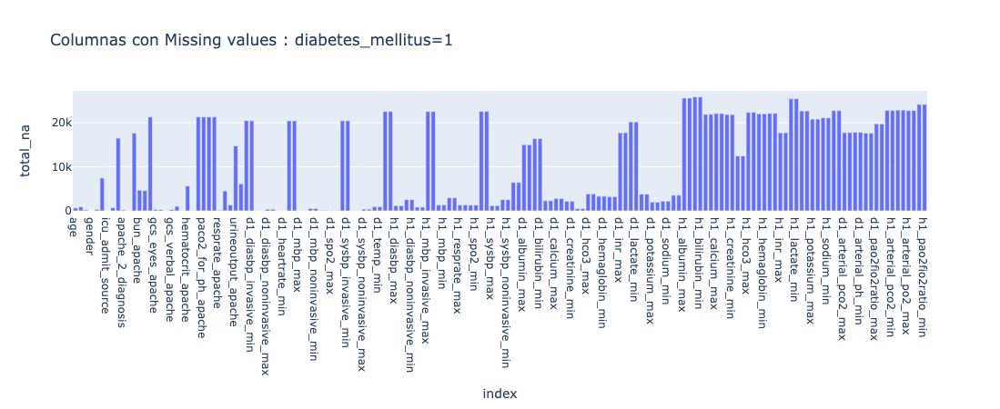

In [19]:
df_missing_by_col_1 = pd.DataFrame(df_training[df_training['diabetes_mellitus'] == 1].isnull().sum(), columns=['total_na']).reset_index()
# df_missing_by_col = df_missing_by_col.sort_values('total_na')
px.bar(df_missing_by_col_1[df_missing_by_col_1['total_na'] > 0], x='index', y='total_na', title="Columnas con Missing values : diabetes_mellitus=1" )

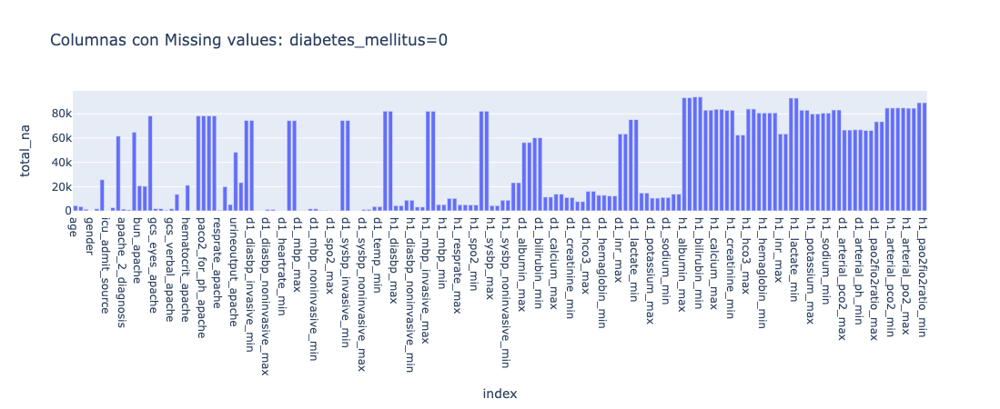

In [20]:
df_missing_by_col_0 = pd.DataFrame(df_training[df_training['diabetes_mellitus'] == 0].isnull().sum(), columns=['total_na']).reset_index()
# df_missing_by_col = df_missing_by_col.sort_values('total_na')
px.bar(df_missing_by_col_0[df_missing_by_col_0['total_na'] > 0], x='index', y='total_na', title="Columnas con Missing values: diabetes_mellitus=0")

### Missing values por fila

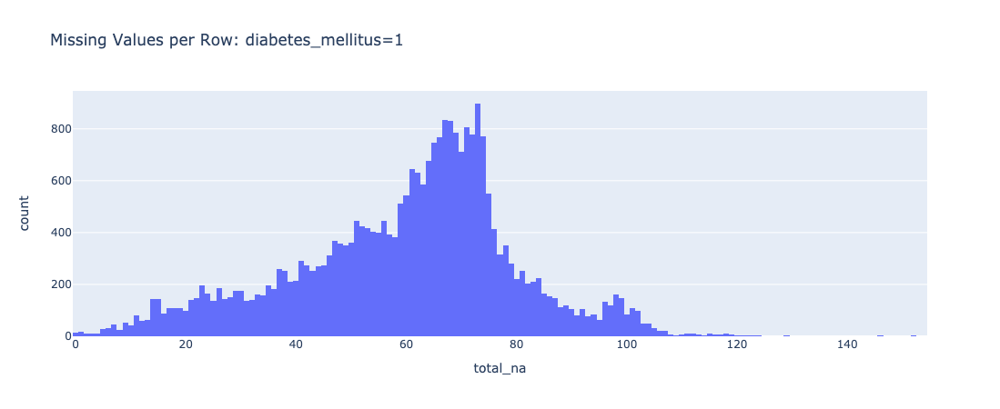

In [21]:
df_missing_by_row_1 = pd.DataFrame(df_training[df_training['diabetes_mellitus'] == 1].isnull().sum(axis=1), columns=['total_na'])
px.histogram(df_missing_by_row_1, x='total_na', title="Missing Values per Row: diabetes_mellitus=1 ")

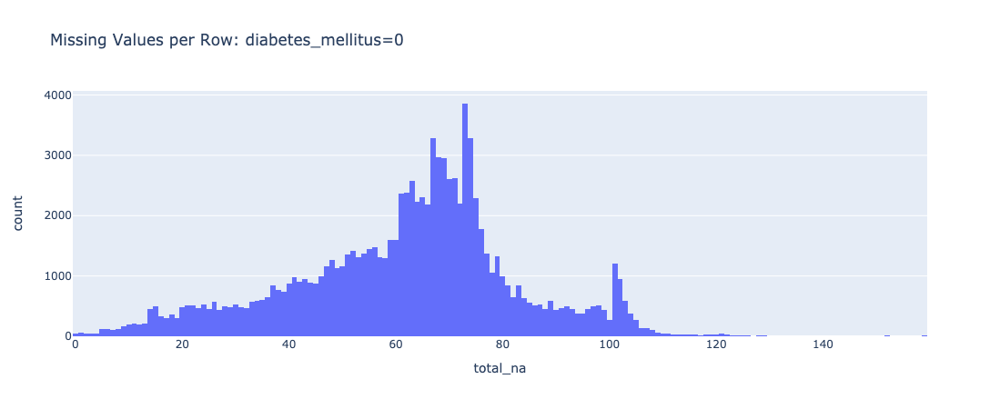

In [22]:
df_missing_by_row_0 = pd.DataFrame(df_training[df_training['diabetes_mellitus'] == 0].isnull().sum(axis=1), columns=['total_na'])
px.histogram(df_missing_by_row_0, x='total_na', title="Missing Values per Row: diabetes_mellitus=0 ")

# Preparación de datos

In [30]:
# Columnas a ignorar durante el entrenamiento
# Las columnas que tienen valores de identificación del paciente serán ignoradas
cols_to_ignore = ['encounter_id', 'Unnamed: 0'] #,	'patient_id']
# Tambien agregaremos a las columnas 
cols_to_ignore += ['diabetes_mellitus']
cols_to_ignore

['encounter_id', 'Unnamed: 0', 'diabetes_mellitus']

In [31]:
flag_normalization = False
if flag_normalization:
  # Data Normalization
  from sklearn.preprocessing import StandardScaler
  scaler = StandardScaler()
  df.iloc[:,0:-1] = scaler.fit_transform(df.iloc[:,0:-1].to_numpy())

### Columnas categóricas y sus valores respectivos

In [32]:
#Columnas de tipo texto
categorical_cols = df_training.select_dtypes(include=['object', 'bool']).columns.tolist()
print("\nValores únicos")
print(df_training[categorical_cols].nunique())

print("\nValores perdidos en columnas de tipo texto ")
print(df_training[categorical_cols].isna().sum())


Valores únicos
ethnicity                 6
gender                    2
hospital_admit_source    15
icu_admit_source          5
icu_stay_type             3
icu_type                  8
dtype: int64

Valores perdidos en columnas de tipo texto 
ethnicity                 1548
gender                       0
hospital_admit_source    33174
icu_admit_source           226
icu_stay_type                0
icu_type                     0
dtype: int64


In [33]:
# Vamos a remover las filas de las personas que no tienen género registrado
# display(df_training[df_training['gender'].isna()])

df_training = df_training[~df_training['gender'].isna()]

In [34]:
# Vamos a convertir los datos 
# Data Transformation
flag_onehotencoding = False

if flag_onehotencoding:
  for col in categorical_cols:
    df_training[col] = df_training[col].astype('category')

    df_dummies = pd.get_dummies(df_training[col], columns=[col])
    df_training = pd.concat([df_training,df_dummies], axis=1 )
    display(df_training.head())

### Selección de variables

In [35]:
from sklearn.feature_selection import SelectKBest

In [36]:
cols_to_use = [col for col in df_training.columns if col not in cols_to_ignore + categorical_cols]
cols_to_use

['hospital_id',
 'age',
 'bmi',
 'elective_surgery',
 'height',
 'icu_id',
 'pre_icu_los_days',
 'readmission_status',
 'weight',
 'albumin_apache',
 'apache_2_diagnosis',
 'apache_3j_diagnosis',
 'apache_post_operative',
 'arf_apache',
 'bilirubin_apache',
 'bun_apache',
 'creatinine_apache',
 'fio2_apache',
 'gcs_eyes_apache',
 'gcs_motor_apache',
 'gcs_unable_apache',
 'gcs_verbal_apache',
 'glucose_apache',
 'heart_rate_apache',
 'hematocrit_apache',
 'intubated_apache',
 'map_apache',
 'paco2_apache',
 'paco2_for_ph_apache',
 'pao2_apache',
 'ph_apache',
 'resprate_apache',
 'sodium_apache',
 'temp_apache',
 'urineoutput_apache',
 'ventilated_apache',
 'wbc_apache',
 'd1_diasbp_invasive_max',
 'd1_diasbp_invasive_min',
 'd1_diasbp_max',
 'd1_diasbp_min',
 'd1_diasbp_noninvasive_max',
 'd1_diasbp_noninvasive_min',
 'd1_heartrate_max',
 'd1_heartrate_min',
 'd1_mbp_invasive_max',
 'd1_mbp_invasive_min',
 'd1_mbp_max',
 'd1_mbp_min',
 'd1_mbp_noninvasive_max',
 'd1_mbp_noninvasive_mi

In [61]:
X = df_training[cols_to_use].fillna(0)
Y = df_training[['diabetes_mellitus']]

### SelectKBest

In [39]:
flag_selectKBest = False
if flag_selectKBest == True:
  feature_selection1 = SelectKBest( k=40)

  #Fit the function for ranking the features by score
  fit = feature_selection1.fit(X, Y)

  #Summarize scores numpy.set_printoptions(precision=3) print(fit.scores_)

  #Apply the transformation on to dataset

  features = fit.transform(X)
  print(features[0:5,:])

In [ ]:
# https://hub.packtpub.com/4-ways-implement-feature-selection-python-machine-learning/

### Random Forest

<ipython-input-51-fbb24926a18e>:7: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



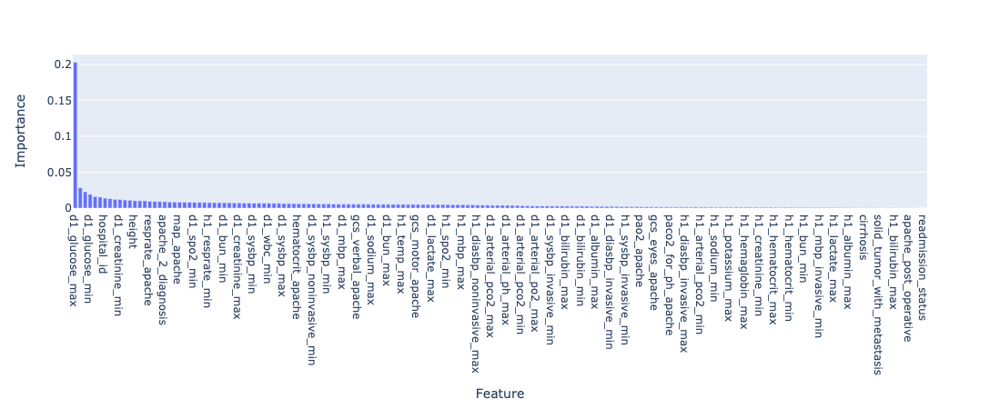

In [51]:
### Random Forest
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor
# Instantiate model with X decision trees
rf = RandomForestRegressor(n_estimators = 10,   )
# Train the model on training data
rf.fit(X, Y)


In [ ]:

feature_imp = (dict(zip(X.columns, rf.feature_importances_)))
importance = pd.DataFrame(feature_imp.items(), columns=['Feature', 'Importance'])

importance.sort_values('Importance', ascending=False, inplace=True)
px.bar(importance,x='Feature', y='Importance' )

In [52]:
display(importance)

,Feature,Importance
99,d1_glucose_max,0.202917
2,bmi,0.028354
5,icu_id,0.022756
100,d1_glucose_min,0.019117
1,age,0.016155
...,...,...
25,intubated_apache,0.000236
12,apache_post_operative,0.000192
20,gcs_unable_apache,0.000159
165,aids,0.000041


## Imputacion de datos

In [62]:
### Imputacion de datos
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="median")

In [63]:
imputer.fit(X)
# imputer.statistics_
X_imp = imputer.transform(X)
X = pd.DataFrame(X_imp, columns=X.columns,
                          index=X.index)

X.head()

,hospital_id,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,readmission_status,weight,albumin_apache,...,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
0,118.0,68.0,22.732803,0.0,180.3,92.0,0.541667,0.0,73.9,2.3,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,81.0,77.0,27.421875,0.0,160.0,90.0,0.927778,0.0,70.2,0.0,...,51.0,51.0,51.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,118.0,25.0,31.952749,0.0,172.7,93.0,0.000694,0.0,95.3,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,118.0,81.0,22.635548,1.0,165.1,92.0,0.000694,0.0,61.7,0.0,...,265.0,337.0,337.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,33.0,19.0,0.000000,0.0,188.0,91.0,0.073611,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### One hot encoding

In [65]:
# Vamos a convertir los datos 
# Data Transformation
flag_onehotencoding = True
df_dummies_all = pd.DataFrame()
if flag_onehotencoding:
    for col in categorical_cols:
        print(col)
        df_training[col] = df_training[col].astype('category')

        df_dummies = pd.get_dummies(df_training[col], columns=[col], dummy_na=True)
        # Join one hot encoder to dataframe
        df_dummies_all = pd.concat([df_dummies_all,df_dummies], axis=1)
df_dummies_all.head()

ethnicity
gender
hospital_admit_source
icu_admit_source
icu_stay_type
icu_type


,African American,Asian,Caucasian,Hispanic,Native American,Other/Unknown,NaN,F,M,NaN,...,NaN,CCU-CTICU,CSICU,CTICU,Cardiac ICU,MICU,Med-Surg ICU,Neuro ICU,SICU,NaN
0,0,0,1,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,0,0
1,0,0,1,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
2,0,0,1,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
3,0,0,1,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,0
4,0,0,1,0,0,0,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0


In [66]:
flag_normalize_data = True
if flag_normalize_data:
    from sklearn.preprocessing import StandardScaler

    scaler = StandardScaler()
    scaler.fit(X)
#     print(scaler.mean_)
    X_normalize = scaler.transform(X)

    X = pd.DataFrame(X_normalize, columns=X.columns, index=X.index)

    display(X.head())

,hospital_id,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,readmission_status,weight,albumin_apache,...,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
0,0.187477,0.411440,-0.554683,-0.484210,0.563764,-1.874859,-0.120140,0.0,-0.273422,0.775147,...,-0.366807,-0.334174,-0.333328,-0.032111,-0.127874,-0.117446,-0.162354,-0.085814,-0.064861,-0.145969
1,-0.395363,0.854451,-0.071107,-0.484210,-0.292129,-1.881432,0.035180,0.0,-0.405260,-0.779567,...,0.367776,0.200671,0.217743,-0.032111,-0.127874,-0.117446,-0.162354,-0.085814,-0.064861,-0.145969
2,0.187477,-1.705164,0.396155,-0.484210,0.243331,-1.871572,-0.337757,0.0,0.489101,-0.779567,...,-0.366807,-0.334174,-0.333328,-0.032111,-0.127874,-0.117446,-0.162354,-0.085814,-0.064861,-0.145969
3,0.187477,1.051344,-0.564713,2.065221,-0.077102,-1.874859,-0.337757,0.0,-0.708131,-0.779567,...,3.450144,3.200002,3.308063,-0.032111,-0.127874,-0.117446,-0.162354,-0.085814,-0.064861,-0.145969
4,-1.151479,-2.000505,-2.899081,-0.484210,0.888413,-1.878146,-0.308425,0.0,-2.906620,-0.779567,...,-0.366807,-0.334174,-0.333328,-0.032111,-0.127874,-0.117446,-0.162354,-0.085814,-0.064861,-0.145969


### Separación de Test y training

In [67]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=1, stratify=Y )

print("Training size : ", len(x_train))
print(y_train['diabetes_mellitus'].value_counts(normalize=True))

print("Test size : ", len(x_test))
print(y_test['diabetes_mellitus'].value_counts(normalize=True))

Training size :  104072
0    0.78364
1    0.21636
Name: diabetes_mellitus, dtype: float64
Test size :  26019
0    0.783658
1    0.216342
Name: diabetes_mellitus, dtype: float64


### Entrenamiento de modelos

In [69]:
from sklearn.linear_model import SGDClassifier

sgd_clf = SGDClassifier(max_iter=1000, tol=1e-3, random_state=42)
sgd_clf.fit(x_train, y_train)

/Users/nathaly/opt/miniconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:72: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



SGDClassifier(random_state=42)

In [70]:
## Predicciones en el dataset de training
y_train_pred = sgd_clf.predict(x_train)
print(y_train_pred)
print("Proporcion de predicciones")
np.array(np.unique(y_train_pred, return_counts=True)).T

[0 0 0 ... 0 1 1]
Proporcion de predicciones


NameError: name 'np' is not defined

In [71]:
from sklearn.metrics import confusion_matrix
print("Confusion Matrix - Training")
confusion_matrix(y_train, y_train_pred)

Confusion Matrix - Training


array([[77121,  4434],
       [15200,  7317]])

In [72]:
def plot_roc_curve(fpr, tpr, label=None):
    plt.plot(fpr, tpr, linewidth=2, label=label)
    plt.plot([0, 1], [0, 1], 'k--') # dashed diagonal
    plt.axis([0, 1, 0, 1])                                    # Not shown in the book
    plt.xlabel('False Positive Rate (Fall-Out)', fontsize=16) # Not shown
    plt.ylabel('True Positive Rate (Recall)', fontsize=16)    # Not shown
    plt.grid(True) 

Precision Score
0.6226704110288486
Recall Store
0.3249544788382111
F1 Score
ROC AUC Score
0.63529313053553


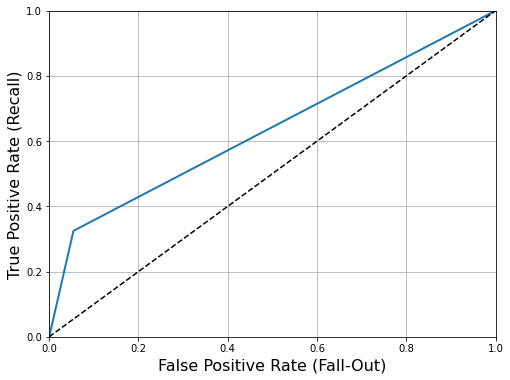

In [75]:
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, roc_curve
print("Precision Score")
print(precision_score(y_train, y_train_pred))
print("Recall Store")
print(recall_score(y_train, y_train_pred))
print("F1 Score")
f1_score(y_train, y_train_pred)
print("ROC AUC Score")
print(roc_auc_score(y_train, y_train_pred))
fpr, tpr, thresholds = roc_curve(y_train, y_train_pred)
                                          

plt.figure(figsize=(8, 6))                         
plot_roc_curve(fpr, tpr, "ROC")

plt.show()
